# Problem Set 6

In [83]:
using Pkg
Pkg.activate(@__DIR__)
Pkg.instantiate()
Pkg.add("DataFrames")
Pkg.add("Binscatters")
Pkg.add("FiniteDifferences")
Pkg.add("Parameters")
Pkg.add("ForwardDiff")
Pkg.add("Statistics")
Pkg.add("LinearAlgebra")
Pkg.add("Plots")
Pkg.add("DataFrames")
Pkg.add("Binscatters")
Pkg.add("Optim")
Pkg.add("Interpolations")
Pkg.add("ApproxFun")
Pkg.add("TexTables")
Pkg.add("LogExpFunctions")
Pkg.add("ProgressMeter")
Pkg.add("LaTeXStrings")
Pkg.add("SpecialFunctions")

# We will load all of the packages we need up here
using Parameters: @unpack
using ForwardDiff: gradient, hessian
using FiniteDifferences: grad, central_fdm
using Statistics: mean
using LinearAlgebra: dot, norm
using Plots
using DataFrames
using Binscatters
using Optim
using Optim: optimize, minimizer, f_calls
using TexTables
using LogExpFunctions
using ProgressMeter
using Interpolations
using LaTeXStrings
using ApproxFun
using SpecialFunctions

  Activating project at `~/Desktop`


   Resolving package versions...
  No Changes to `~/Desktop/Project.toml`
  No Changes to `~/Desktop/Manifest.toml`
   Resolving package versions...
  No Changes to `~/Desktop/Project.toml`
  No Changes to `~/Desktop/Manifest.toml`
   Resolving package versions...
  No Changes to `~/Desktop/Project.toml`
  No Changes to `~/Desktop/Manifest.toml`
   Resolving package versions...
  No Changes to `~/Desktop/Project.toml`
  No Changes to `~/Desktop/Manifest.toml`
   Resolving package versions...
  No Changes to `~/Desktop/Project.toml`
  No Changes to `~/Desktop/Manifest.toml`
   Resolving package versions...
  No Changes to `~/Desktop/Project.toml`
  No Changes to `~/Desktop/Manifest.toml`
   Resolving package versions...
  No Changes to `~/Desktop/Project.toml`
  No Changes to `~/Desktop/Manifest.toml`
   Resolving package versions...
  No Changes to `~/Desktop/Project.toml`
  No Changes to `~/Desktop/Manifest.toml`
   Resolving package versions...
  No Changes to `~/Desktop/Project.toml

## Exercise 1
### Exercise 1a

In [84]:
## Define the functions and set up for the loop to create the graphs:

function f1(x)
    if -1 <= x <= 1
        return exp(2*x + 2)
    else 
        return NaN
    end
end

function f2(x)
    if -1 <= x <= 1
        return min(max(-1, 4(x - (1/5))),1)
    else
        return NaN
    end
end

function f3(x)
    if 1e-4 <= x <= 1
        return -2 * x^(-1/2)
    else
        return NaN
    end
end

function f4(x)
    if -5 <= x <= 5
        return 1 / (1 + x^2)
    else
        return NaN
    end
end

T(n, x) = cos(n * acos(x))

T (generic function with 1 method)

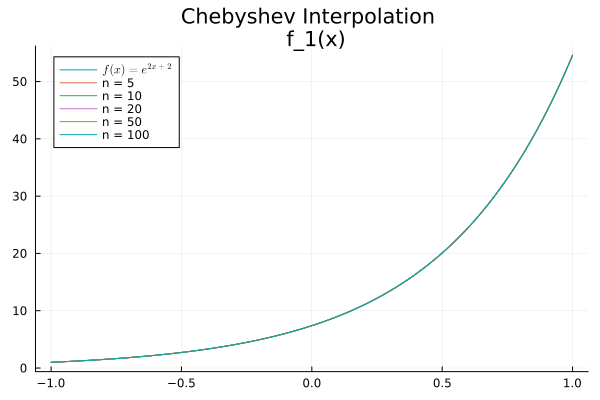

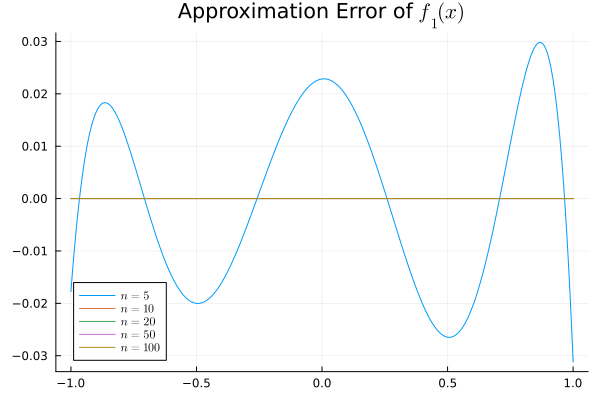

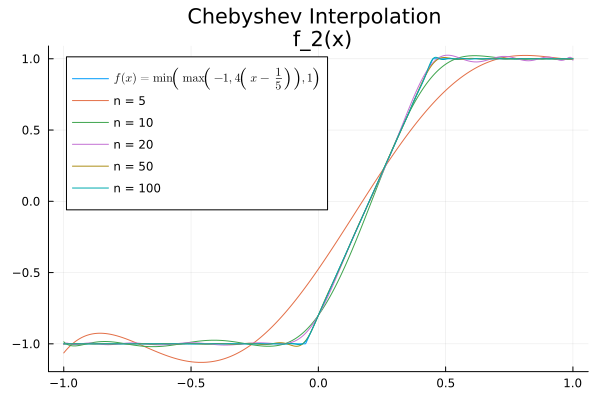

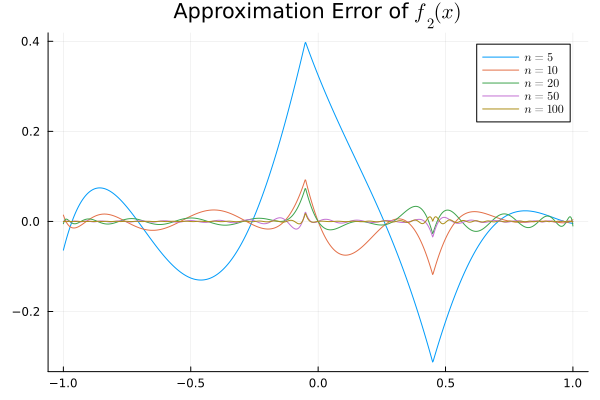

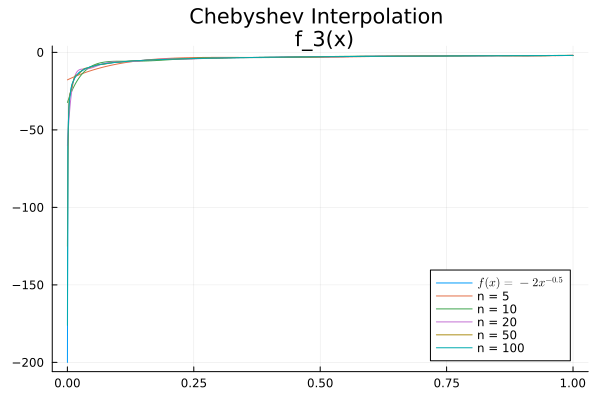

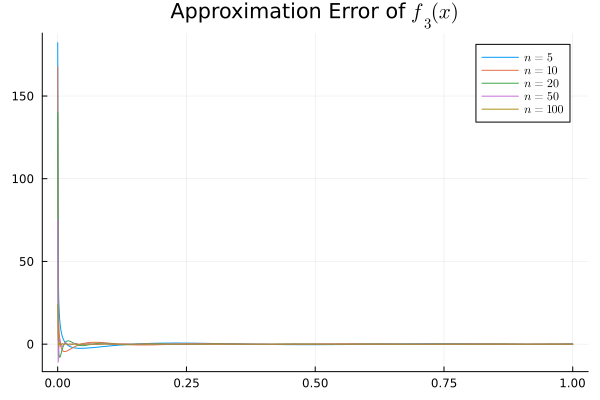

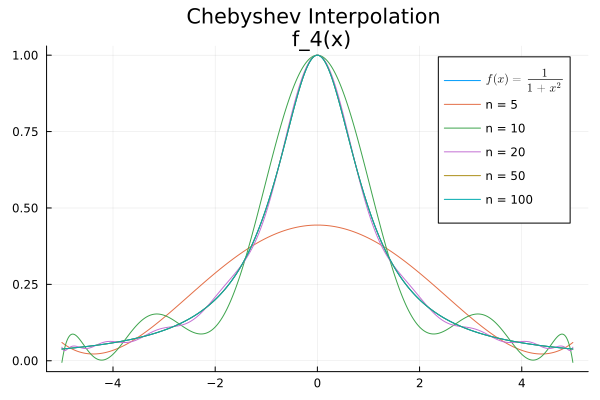

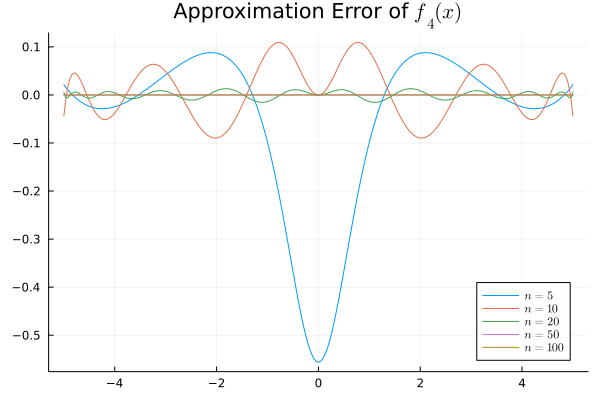

In [85]:
# Call the functions to create the Chebyshev graphs

let n_grid = [5, 10, 20, 50, 100]
    functions = [(f1, -1, 1, "f_1(x)", "e^{2x+2}"), (f2, -1, 1, "f_2(x)", "\\min\\left(\\max\\left(-1, 4\\left(x - \\frac{1}{5}\\right)\\right),1\\right)"), (f3, 1e-4, 1, "f_3(x)", "-2x^{-0.5}"), (f4, -5, 5, "f_4(x)", "\\frac{1}{1+x^2}")]
    for (f, f_a, f_b, f_label, f_exp) in functions
        p = plot(title = "Chebyshev Interpolation \n $(f_label)")
        approx_error = plot(title = "Approximation Error of \$$(f_label)\$")
        for n in n_grid
            i = 0
            i += 1 
            m = n + 1
            z = [-cos((2k -1)/(2m) * π) for k = 1:m] # interpolation points
            x = (z .+ 1) .* (f_b - f_a)/2 .+ f_a
            y = f.(x)

            c = map(0:m) do i 
                numerator   = sum(y[k] * T(i, z[k]) for k in 1:m)
                denominator = sum(T(i, z[k])^2      for k in 1:m)
                return numerator/denominator
            end

            f_hat(x) = sum(
                ci * T(i, 2 * (x-f_a)/(f_b-f_a) - 1) 
                for (ci, i) in zip(c, 0:n)
            )
            
            xg = LinRange(f_a, f_b, 1000) 
            if n == n_grid[1]
                plot!(p, xg, f, label = "\$f(x) = $(f_exp)\$")
            end
            plot!(p, xg, f_hat, label = "n = $n")
            plot!(approx_error, xg, f_hat.(xg) .- f.(xg), label = "\$n = $n\$")
        end
        display(p)
        display(approx_error)
    end
end

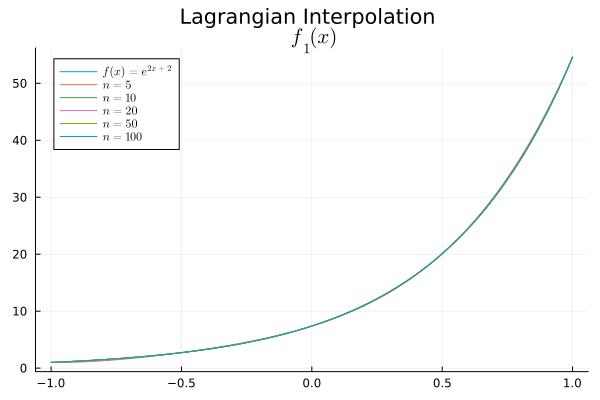

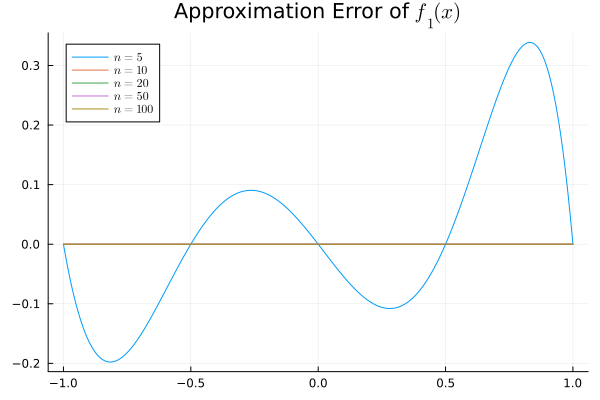

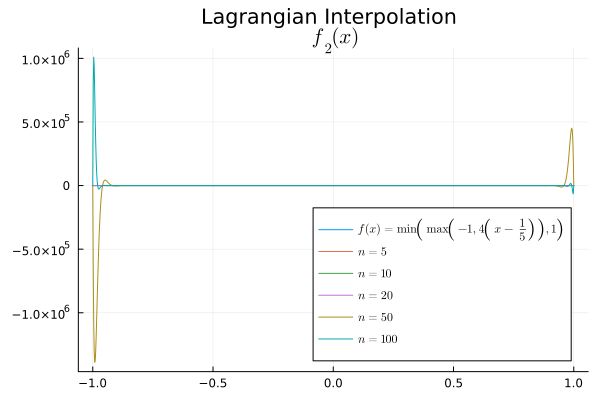

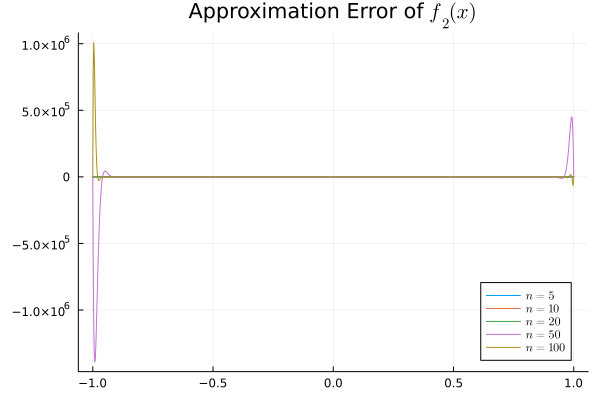

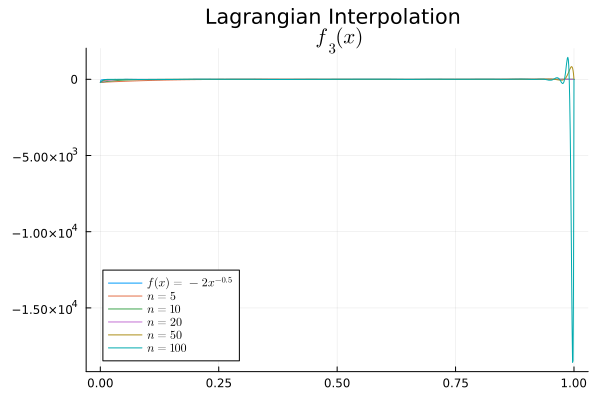

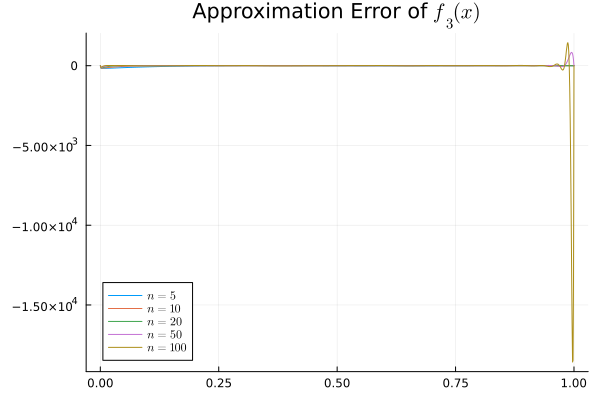

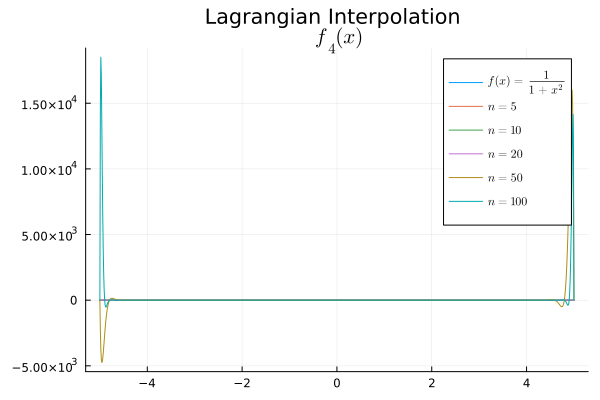

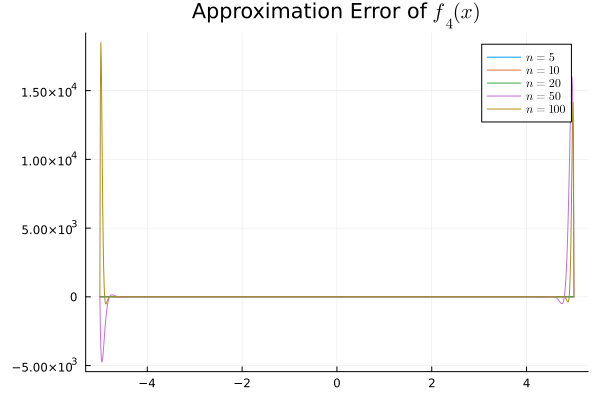

In [86]:
# Lagrangian Interpolation


function vandermonde(X)
    n = length(X)
    V = [xi^s for xi in X, s in 0:n-1]
    return V
end

lagrange(X,y)  = vandermonde(X)\y

function evaluate(a, x)
    xi = 1
    v  = 0.0
    for ai in a
        v += ai * xi 
        xi *= x
    end
    return v
    # return sum(
    #     a[s] * x^(s-1)
    #     for s in eachindex(a)
    # )
end

let n_grid = [5, 10, 20, 50, 100]
    functions = [(f1, -1, 1, "f_1(x)", "e^{2x+2}"), (f2, -1, 1, "f_2(x)", "\\min\\left(\\max\\left(-1, 4\\left(x - \\frac{1}{5}\\right)\\right),1\\right)"), (f3, 1e-4, 1, "f_3(x)", "-2x^{-0.5}"), (f4, -5, 5, "f_4(x)", "\\frac{1}{1+x^2}")]
    for (f, f_a, f_b, f_label, f_exp) in functions
        p = plot(title = "Lagrangian Interpolation \n \$ $(f_label)\$")
        approx_error = plot(title = "Approximation Error of \$$(f_label)\$")
        for n in n_grid
            x = LinRange(f_a, f_b, n)
            y = f.(x)

            l = lagrange(x, y)
            f_hat(x) = evaluate(l, x)
            
            xg = LinRange(f_a, f_b, 1000) 
            if n == n_grid[1]
                plot!(p, xg, f, label = "\$f(x) = $(f_exp)\$")
            end
            plot!(p, xg, f_hat, label = "\$n = $n\$")
            plot!(approx_error, xg, f_hat.(xg) .- f.(xg), label = "\$n = $n\$")
        end
        display(p)
        display(approx_error)
    end
end

The graph above suggests that the Runge phenomenon is present as we get explosive oscillations near the boundaries of the interval over which the function is being interpolated. The underlying cause of this is that polynomial functions of high degree have a high degree of flexibility which causes them to "over-fit" the provided data points which leads to large deviations between the interpolation points, especially near the edges.

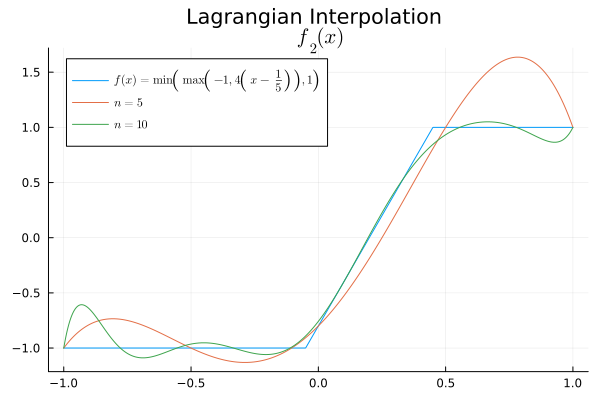

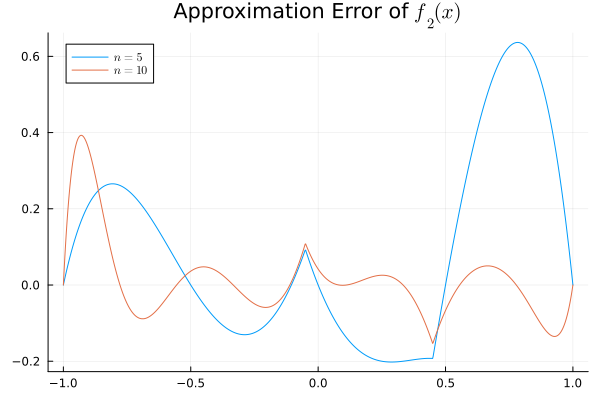

In [87]:
let n_grid = [5, 10]
    functions = [(f2, -1, 1, "f_2(x)", "\\min\\left(\\max\\left(-1, 4\\left(x - \\frac{1}{5}\\right)\\right),1\\right)")]
    for (f, f_a, f_b, f_label, f_exp) in functions
        p = plot(title = "Lagrangian Interpolation \n \$ $(f_label)\$")
        approx_error = plot(title = "Approximation Error of \$$(f_label)\$")
        for n in n_grid
            x = LinRange(f_a, f_b, n)
            y = f.(x)

            l = lagrange(x, y)
            f_hat(x) = evaluate(l, x)
            
            xg = LinRange(f_a, f_b, 1000) 
            if n == n_grid[1]
                plot!(p, xg, f, label = "\$f(x) = $(f_exp)\$")
            end
            plot!(p, xg, f_hat, label = "\$n = $n\$")
            plot!(approx_error, xg, f_hat.(xg) .- f.(xg), label = "\$n = $n\$")
        end
        display(p)
        display(approx_error)
    end
end

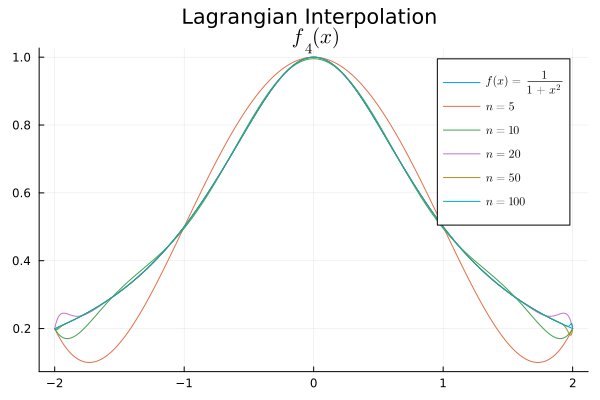

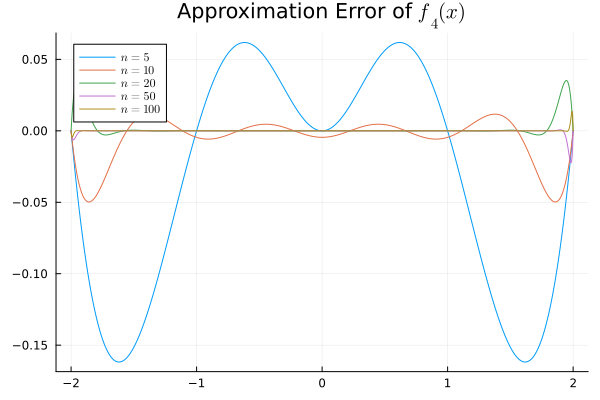

In [88]:
let n_grid = [5, 10, 20, 50, 100]
    functions = [(f4, -2, 2, "f_4(x)", "\\frac{1}{1+x^2}")]
    for (f, f_a, f_b, f_label, f_exp) in functions
        p = plot(title = "Lagrangian Interpolation \n \$ $(f_label)\$")
        approx_error = plot(title = "Approximation Error of \$$(f_label)\$")
        for n in n_grid
            x = LinRange(f_a, f_b, n)
            y = f.(x)

            l = lagrange(x, y)
            f_hat(x) = evaluate(l, x)
            
            xg = LinRange(f_a, f_b, 1000) 
            if n == n_grid[1]
                plot!(p, xg, f, label = "\$f(x) = $(f_exp)\$")
            end
            plot!(p, xg, f_hat, label = "\$n = $n\$")
            plot!(approx_error, xg, f_hat.(xg) .- f.(xg), label = "\$n = $n\$")
        end
        display(p)
        display(approx_error)
    end
end

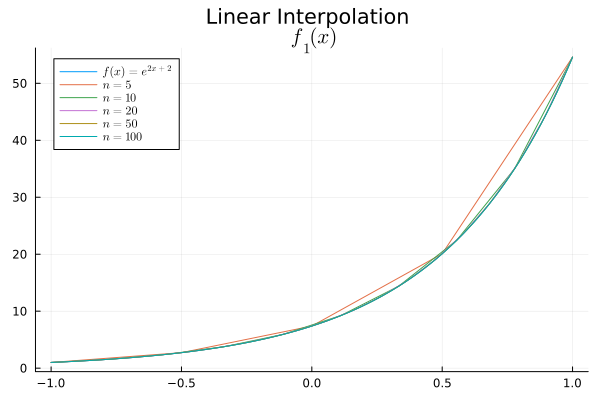

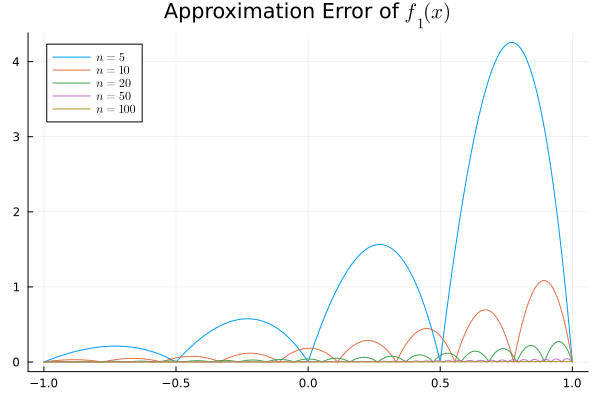

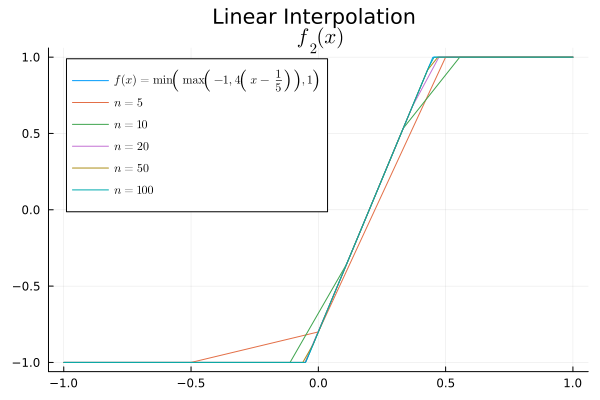

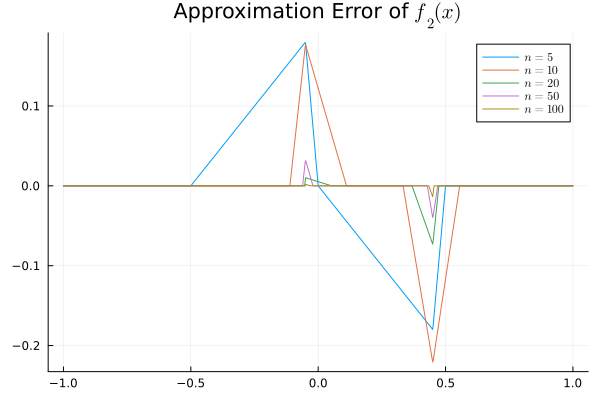

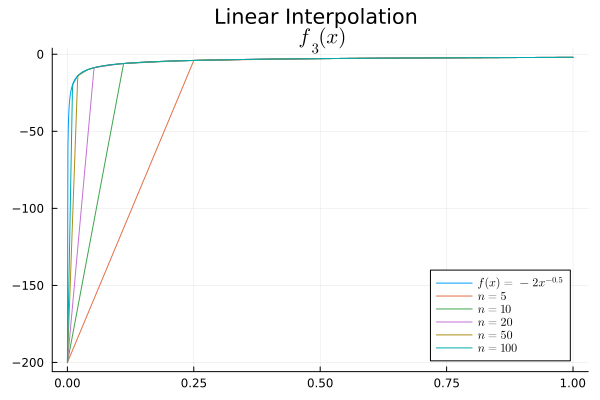

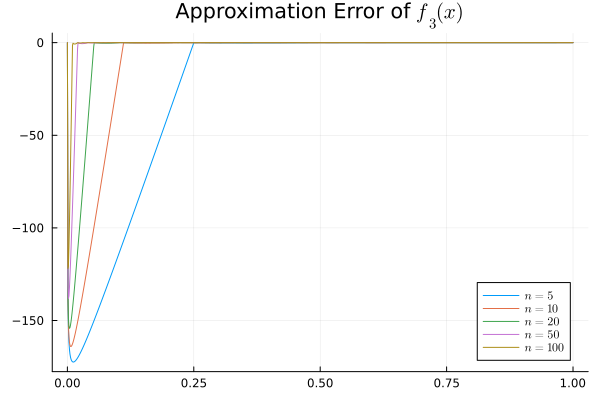

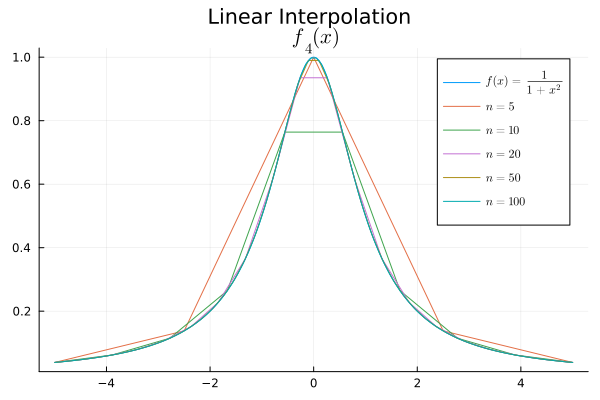

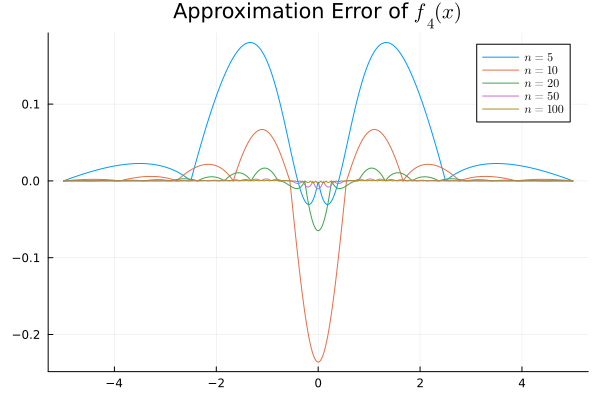

In [89]:
# Linear Interpolation

let n_grid = [5, 10, 20, 50, 100]
    functions = [(f1, -1, 1, "f_1(x)", "e^{2x+2}"), (f2, -1, 1, "f_2(x)", "\\min\\left(\\max\\left(-1, 4\\left(x - \\frac{1}{5}\\right)\\right),1\\right)"), (f3, 1e-4, 1, "f_3(x)", "-2x^{-0.5}"), (f4, -5, 5, "f_4(x)", "\\frac{1}{1+x^2}")]
    for (f, f_a, f_b, f_label, f_exp) in functions
        p = plot(title = "Linear Interpolation \n \$ $(f_label)\$")
        approx_error = plot(title = "Approximation Error of \$$(f_label)\$")
        for n in n_grid
            x = collect(LinRange(f_a, f_b, n))
            y = f.(x)

            f_hat = interpolate((x,), y, Gridded(Linear()))
            
            xg = LinRange(f_a, f_b, 1000) 
            if n == n_grid[1]
                plot!(p, xg, f, label = "\$f(x) = $(f_exp)\$")
            end
            plot!(p, xg, f_hat(xg), label = "\$n = $n\$")
            plot!(approx_error, xg, f_hat.(xg) .- f.(xg), label = "\$n = $n\$")
        end
        display(p)
        display(approx_error)
    end
end

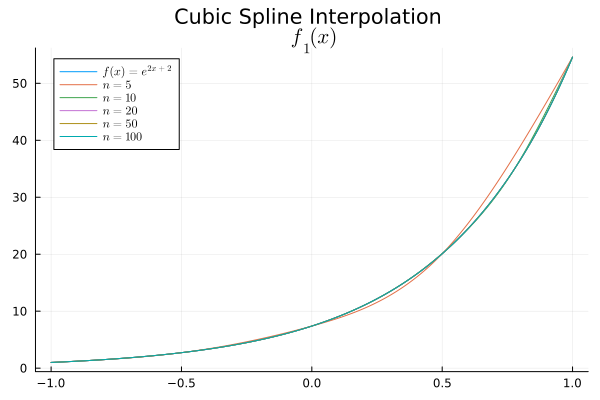

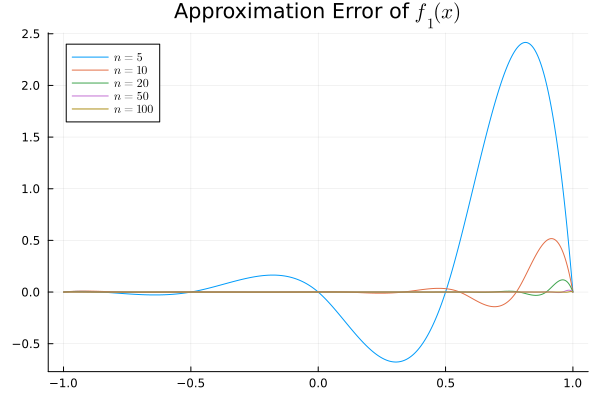

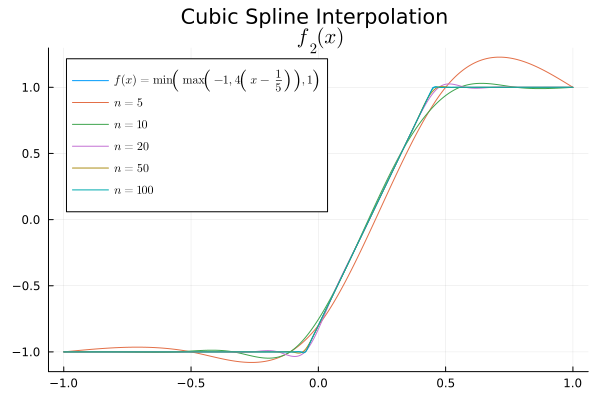

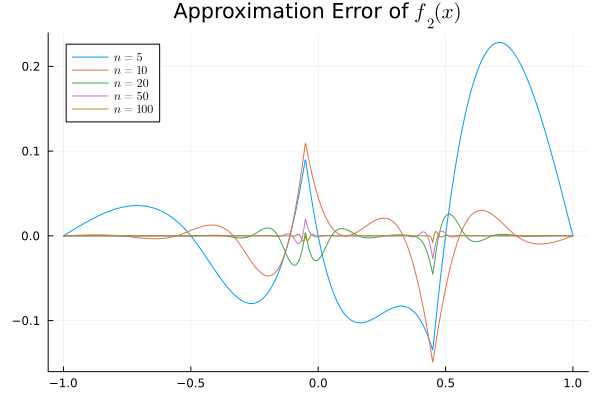

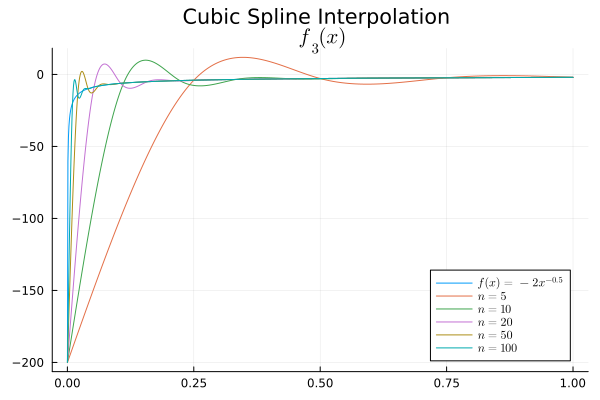

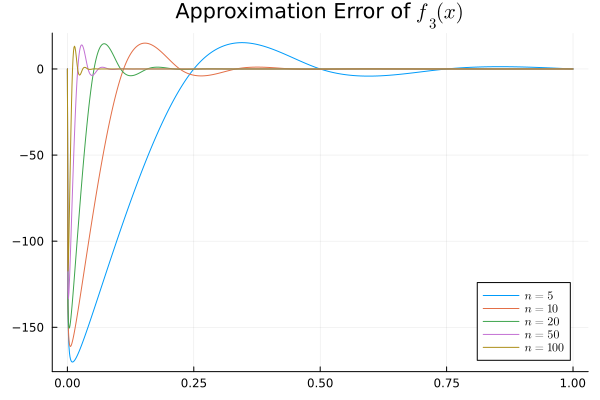

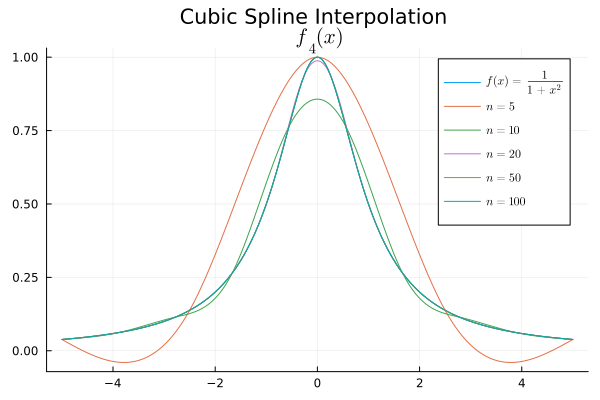

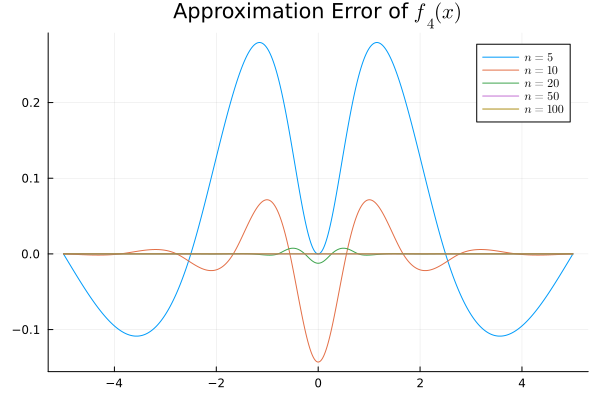

In [90]:
# Cubic Spline Interpolation

let n_grid = [5, 10, 20, 50, 100]
    functions = [(f1, -1, 1, "f_1(x)", "e^{2x+2}"), (f2, -1, 1, "f_2(x)", "\\min\\left(\\max\\left(-1, 4\\left(x - \\frac{1}{5}\\right)\\right),1\\right)"), (f3, 1e-4, 1, "f_3(x)", "-2x^{-0.5}"), (f4, -5, 5, "f_4(x)", "\\frac{1}{1+x^2}")]
    for (f, f_a, f_b, f_label, f_exp) in functions
        p = plot(title = "Cubic Spline Interpolation \n \$ $(f_label)\$")
        approx_error = plot(title = "Approximation Error of \$$(f_label)\$")
        for n in n_grid
            x = LinRange(f_a, f_b, n)
            y = f.(x)

            f_hat = CubicSplineInterpolation(x, y)
            
            xg = LinRange(f_a, f_b, 1000) 
            if n == n_grid[1]
                plot!(p, xg, f, label = "\$f(x) = $(f_exp)\$")
            end
            plot!(p, xg, f_hat(xg), label = "\$n = $n\$")
            plot!(approx_error, xg, f_hat.(xg) .- f.(xg), label = "\$n = $n\$")
        end
        display(p)
        display(approx_error)
    end
end

### Problem 1b

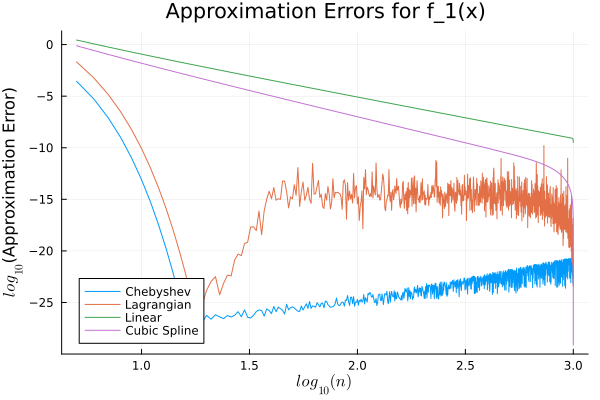

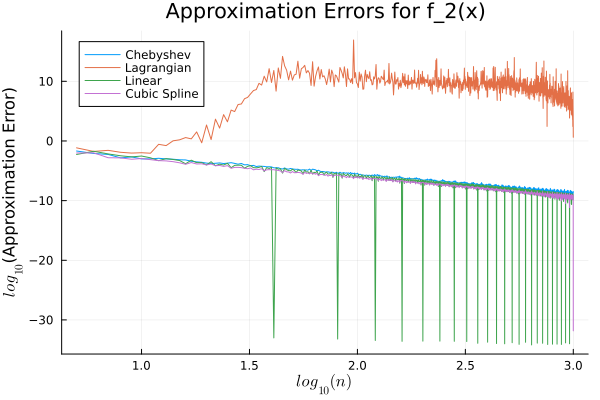

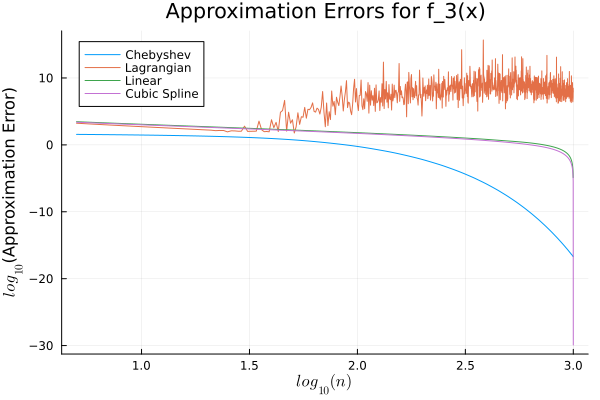

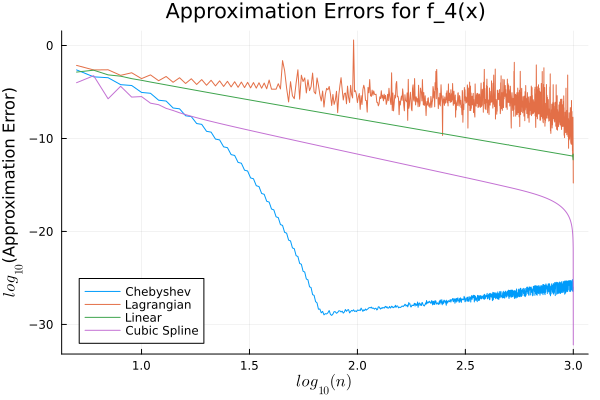

In [91]:
functions = [(f1, -1, 1, "f_1(x)", "e^{2x+2}"), (f2, -1, 1, "f_2(x)", "\\min\\left(\\max\\left(-1, 4\\left(x - \\frac{1}{5}\\right)\\right),1\\right)"), (f3, 1e-4, 1, "f_3(x)", "-2x^{-0.5}"), (f4, -2, 2, "f_4(x)", "\\frac{1}{1+x^2}")]


for (f, f_a, f_b, f_label, f_exp) in functions
    n_grid = 5:1000
    approx_errors = Dict("Chebyshev" => [], "Lagrangian" => [], "Linear" => [], "Cubic Spline" => [])
    for n in n_grid
        xg = LinRange(f_a, f_b, 1000)
        m = n + 1

        # Chebyshev Interpolation
        z_Cheb = [-cos((2k -1)/(2m) * π) for k = 1:m] # interpolation points
        x_Cheb = (z_Cheb .+ 1) .* (f_b - f_a)/2 .+ f_a
        y_Cheb = f.(x_Cheb)

        c = map(0:m) do i 
            numerator   = sum(y_Cheb[k] * T(i, z_Cheb[k]) for k in 1:m)
            denominator = sum(T(i, z_Cheb[k])^2      for k in 1:m)
            return numerator/denominator
        end

        f_hat_Cheb(x_Cheb) = sum(
                ci * T(i, 2 * (x_Cheb-f_a)/(f_b-f_a) - 1) 
                for (ci, i) in zip(c, 0:n)
            )

        approx_error_Cheb = mean(x_Cheb -> x_Cheb^2, f_hat_Cheb.(xg) - f.(xg))
        push!(approx_errors["Chebyshev"], approx_error_Cheb)

        # Lagrangian Interpolation
        x_Lag = LinRange(f_a, f_b, n)
        y_Lag = f.(x_Lag)
        function vandermonde(x_Lag)
            n = length(x_Lag)
            V = [xi^s for xi in x_Lag, s in 0:n-1]
            return V
        end
        
        lagrange(x_Lag,y_Lag)  = vandermonde(x_Lag) \ y_Lag
        l_Lag = lagrange(x_Lag, y_Lag)
        function evaluate(a, x_Lag)
            xi = 1
            v  = 0.0
            for ai in a
                v += ai * xi 
                xi *= x_Lag
            end
            return v
        end
        f_hat_Lag(x_Lag) = evaluate(l_Lag, x_Lag)
        approx_error_Lag = mean(x_Lag -> x_Lag^2, f_hat_Lag.(xg) - f.(xg))
        push!(approx_errors["Lagrangian"], approx_error_Lag)

        # Linear Interpolation
        x_Lin = collect(LinRange(f_a, f_b, n))
        y_Lin = f.(x_Lag)
        f_hat_Lin = interpolate((x_Lag,), y_Lin, Gridded(Linear()))
        approx_error_Lin = mean(x_Lin -> x_Lin^2, f_hat_Lin.(xg) - f.(xg))
        push!(approx_errors["Linear"], approx_error_Lin)

        # Cubic Spline Interpolation
        x_Cub = LinRange(f_a, f_b, n)
        y_Cub = f.(x_Cub)
        f_hat_Cub = CubicSplineInterpolation(x_Cub, y_Cub)
        approx_error_Cub = mean(x_Cub -> x_Cub^2, f_hat_Cub.(xg) - f.(xg))
        push!(approx_errors["Cubic Spline"], approx_error_Cub)
    end

    n_length = length(n_grid)
    p = plot(log10.(n_grid[1:n_length]), log10.(approx_errors["Chebyshev"][1:n_length]), label = "Chebyshev", xlabel = "\$log_{10}(n)\$", ylabel = "\$log_{10}\$(Approximation Error)", title = "Approximation Errors for $(f_label)")
    plot!(p, log10.(n_grid[1:n_length]), log10.(approx_errors["Lagrangian"][1:n_length]), label = "Lagrangian")
    plot!(p, log10.(n_grid[1:n_length]), log10.(approx_errors["Linear"][1:n_length]), label = "Linear")
    plot!(p, log10.(n_grid[1:n_length]), log10.(approx_errors["Cubic Spline"][1:n_length]), label = "Cubic Spline")
    display(p)
end

## Exercise 2
### Exercise 2a

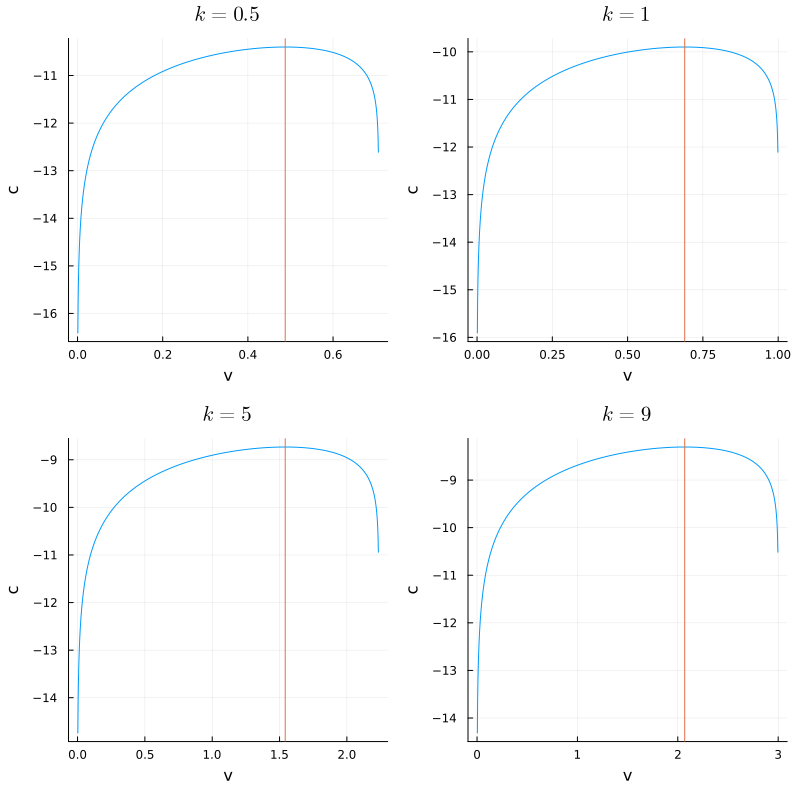

In [92]:
using Plots
# Define parameters
a = -10
b = 0.5
α = 0.5
β = 0.9

# Utility function
v(k) = a + b*log(k)

#Solve for minimum function value and minimum value of k
function solver(α, β,  v, k)
    res = optimize( c -> - (log(c) + β * v(k^α - c)), 1e-4, k^α - 1e-4)
    vmax = - Optim.minimum(res)
    cmax = Optim.minimizer(res)  
    return (; v = vmax, c = cmax)
end

v(a, b) = k -> a + b * log(k)

function objective_plot(α, β, v, k; kwargs...)
    
    # Plot the objective function
    obj(c) = log(c) + β * v(k^α - c)
    cg     = LinRange(0, k^α, 1000)
    plt = plot(cg, obj;
        xlabel = "\$c\$", 
        ylabel = "Utility", 
        label = "Objective Function", 
        kwargs...
    )
    
    # Solve the problem and plot the true values 
    c = solver(α, β, v, k)
    vline!(plt, [c], label = "Optimal Choice of \$c\$")

    return plt
end

plts = []
push!(plts, objective_plot(α, β, v(-10, .5), .5, title = "\$k = 0.5\$"))
push!(plts, objective_plot(α, β, v(-10, .5), 1, title = "\$k = 1\$"))
push!(plts, objective_plot(α, β, v(-10, .5), 5, title = "\$k = 5\$"))
push!(plts, objective_plot(α, β, v(-10, .5), 9, title = "\$k = 9\$"))

plot(plts[1], plts[2], plts[3], plts[4], layout = (2, 2), size = (800, 800), legend = false)

### Problem 2b

## Linear Interpolation

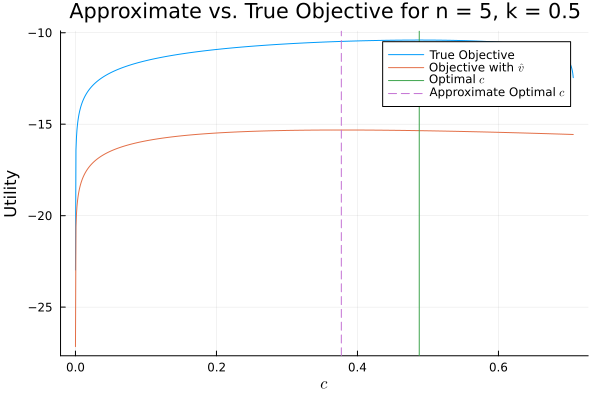

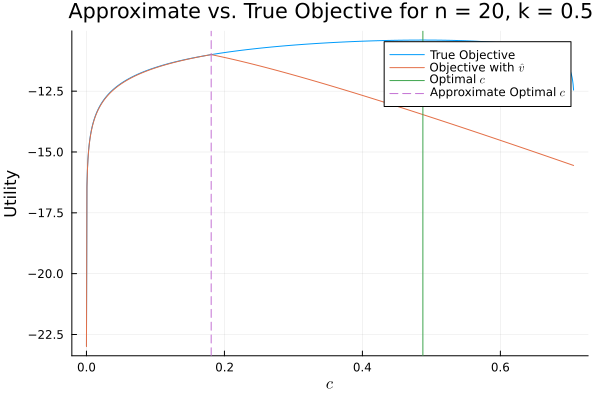

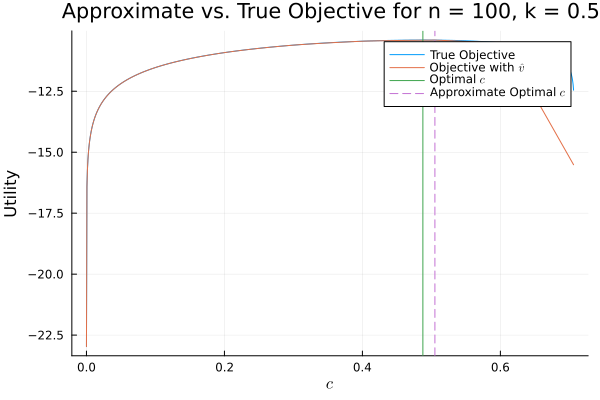

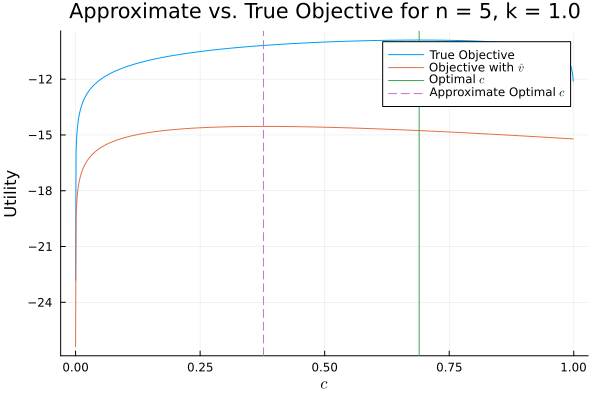

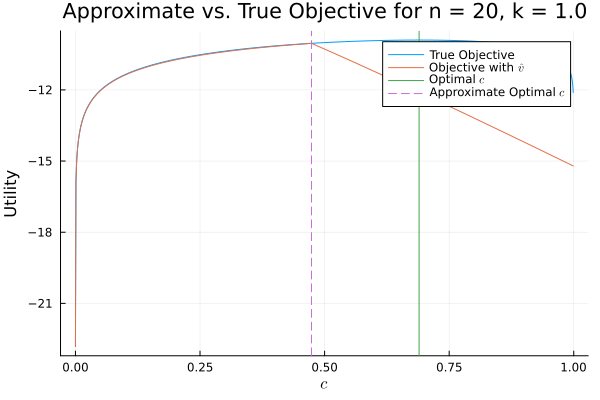

...

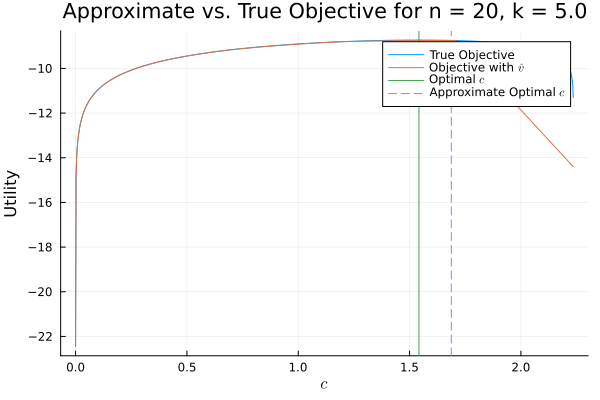

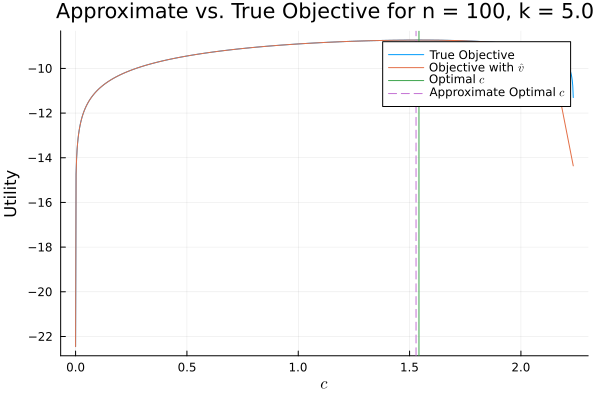

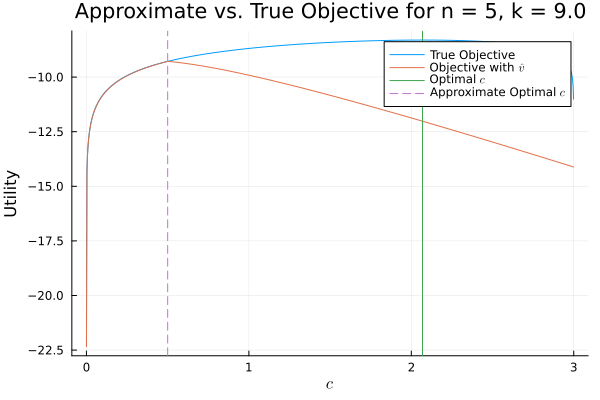

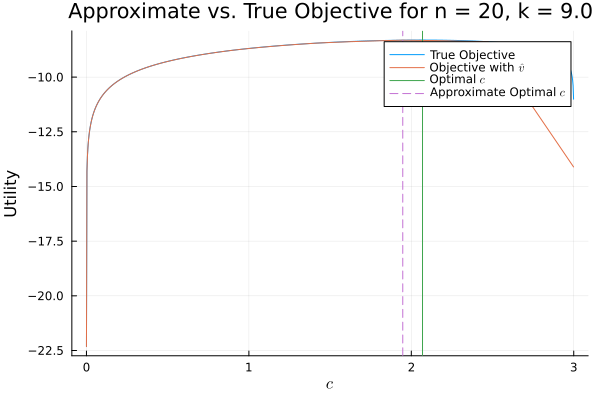

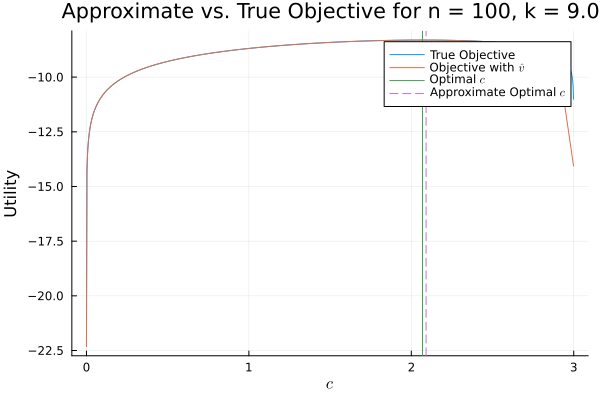

In [93]:
#Linear Interpolation
using Plots, Optim, Interpolations

# Define parameters
a = -10
b = 0.5
α = 0.5
β = 0.9

# Utility function
v(k) = a + b*log(k)

# Solve for minimum function value and minimum value of k
function solver(α, β, v, k)
    res = optimize(c -> - (log(c) + β * v(k^α - c)), 1e-3, k^α - 1e-3)
    vmax = - Optim.minimum(res)
    cmax = Optim.minimizer(res)  
    return (; v = vmax, c = cmax)
end

function approximated_objective_plot(α, β, v, k; n=100, title="Objective Function", kwargs...)
    # Define a grid of k values
    k_grid = range(1e-6, stop=10, length=n)

    # Evaluate v at these grid points
    v_values = v.(k_grid)

    # Create the approximation
    v̂ = LinearInterpolation(k_grid, v_values, extrapolation_bc=Interpolations.Throw())  # Ensures extrapolation throws an error

    # Define the objective functions with clamped input to v̂
    true_obj(c) = log(c) + β * v(k^α - c)
    approx_obj(c) = log(c) + β * v̂(clamp(k^α - c, minimum(k_grid), maximum(k_grid)))

    # Plot the objective functions
    cg = LinRange(0 + 1e-6, k^α - 1e-3, 1000)
    plt = plot(cg, true_obj, label="True Objective", xlabel="\$c\$", ylabel="Utility", title=title, legend=:topright)
    plot!(plt, cg, approx_obj, label="Objective with \$\\hat{v}\$", kwargs...)

    # Solve the problem and plot the true and approximate optimal c
    @unpack c = solver(α, β, v, k)
    vline!(plt, [c], label="Optimal \$c\$")

    @unpack c = solver(α, β, v̂, k)
    vline!(plt, [c], linestyle=:dash, label="Approximate Optimal \$c\$")

    return plt
end

n_values = [5, 20, 100]
k_values = [0.5, 1, 5, 9]

for k in k_values
    for n in n_values
        title = "Approximate vs. True Objective for n = $n, k = $k"
        plt = approximated_objective_plot(α, β, v, k, n=n, title=title)
        display(plt)
    end
end   

## Cubic Splines

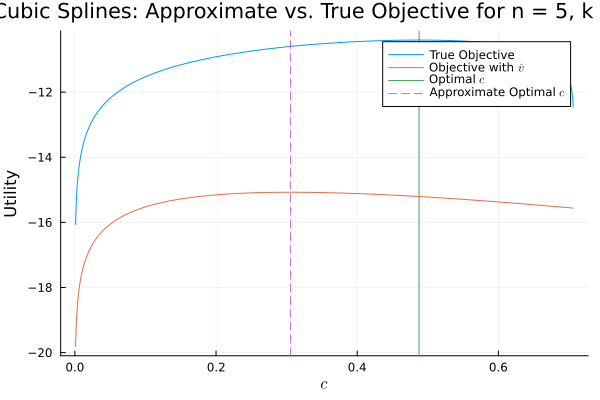

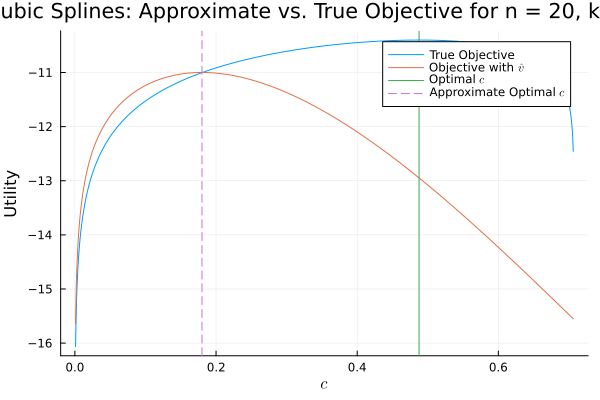

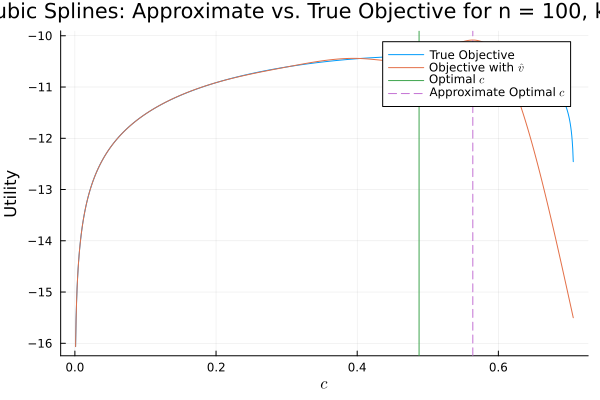

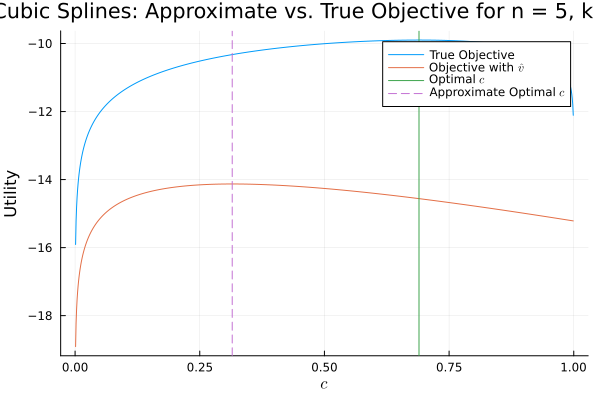

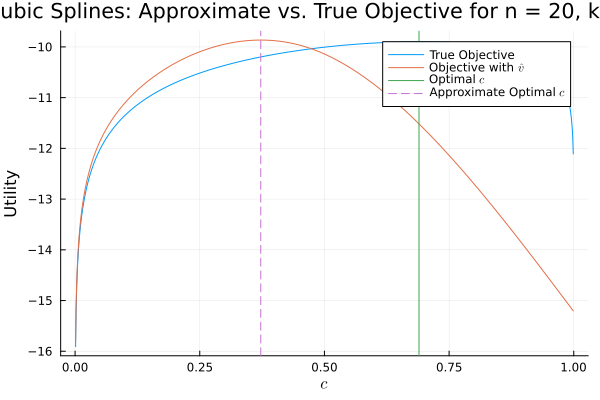

...

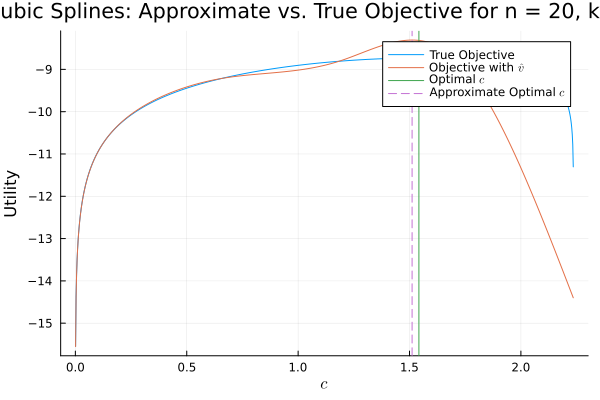

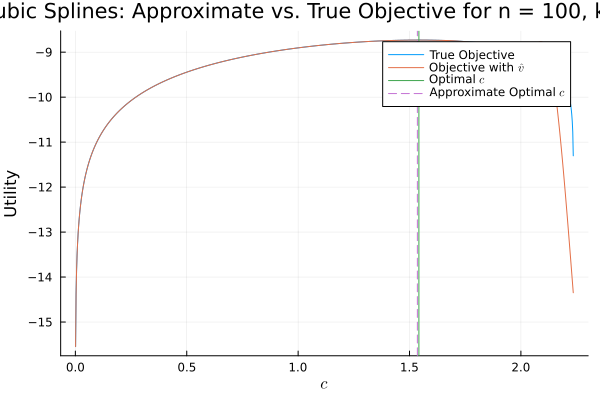

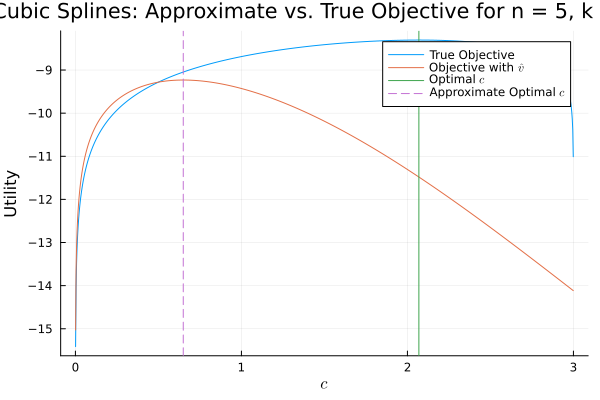

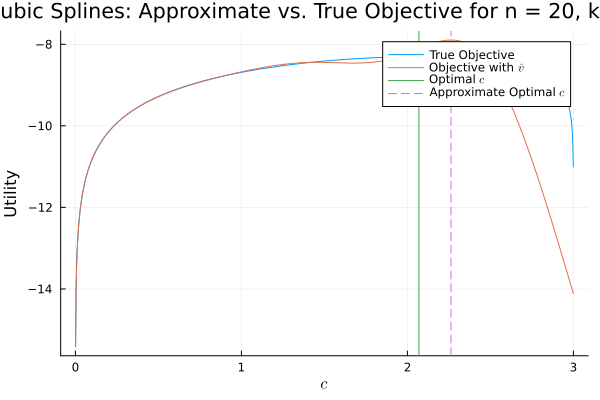

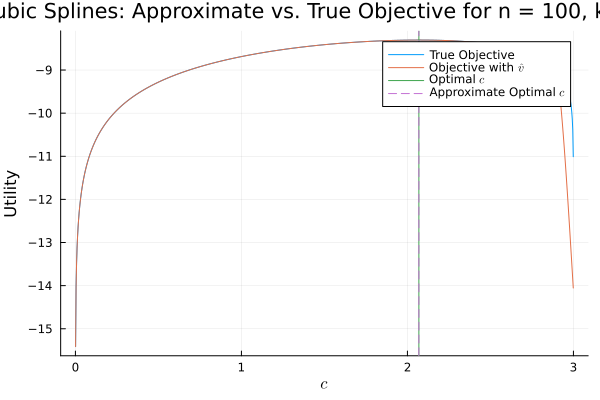

In [94]:
using Plots, Optim, Interpolations

# Define parameters
a = -10
b = 0.5
α = 0.5
β = 0.9

# Utility function
v(k) = a + b * log(k)

# Solve for minimum function value and minimum value of k
function solver(α, β, v, k)
    res = optimize(c -> - (log(c) + β * v(k^α - c)), 1e-3, k^α - 1e-3)
    vmax = - Optim.minimum(res)
    cmax = Optim.minimizer(res)  
    return (; v = vmax, c = cmax)
end

function approximated_objective_plot(α, β, v, k; n=20, kwargs...)
    # Define a grid of k values
    k_grid = range(1e-6, stop=10, length=n)

    # Evaluate v at these grid points
    v_values = v.(k_grid)

    # Create the approximation using cubic spline interpolation
    v̂ = CubicSplineInterpolation(k_grid, v_values)

    # Define the objective functions
    true_obj(c) = log(c) + β * v(k^α - c)
    approx_obj(c) = log(c) + β * v̂(k^α - c)

    # Plot the objective functions
    cg = LinRange(1e-3, k^α - 1e-3, 1000)
    plt = plot(cg, true_obj, label="True Objective", xlabel="\$c\$", ylabel="Utility", 
               title="Cubic Splines: Approximate vs. True Objective for n = $n, k = $k", legend=:topright)
    plot!(plt, cg, approx_obj, label="Objective with \$\\hat{v}\$")

    # Solve the problem and plot the true and approximate optimal c
    @unpack c = solver(α, β, v, k)
    vline!(plt, [c], label="Optimal \$c\$")

    @unpack c = solver(α, β, v̂, k)
    vline!(plt, [c], linestyle=:dash, label="Approximate Optimal \$c\$")

    return plt
end

# Define values to loop over
n_values = [5, 20, 100]
k_values = [0.5, 1, 5, 9]

# Generate and display plots for each combination of k and n values
for k in k_values
    for n in n_values
        plt = approximated_objective_plot(α, β, v, k; n=n)
        display(plt)
    end
end

## Chebyshev Polynomials

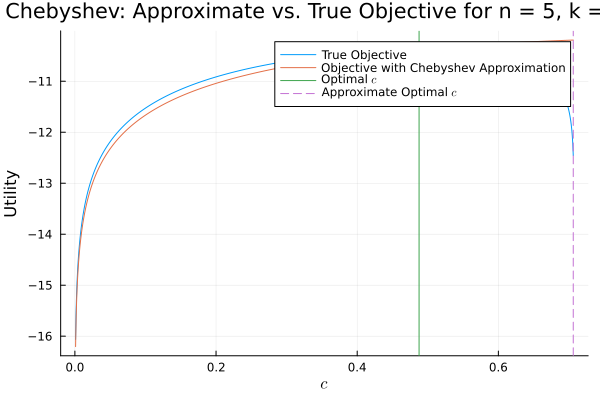

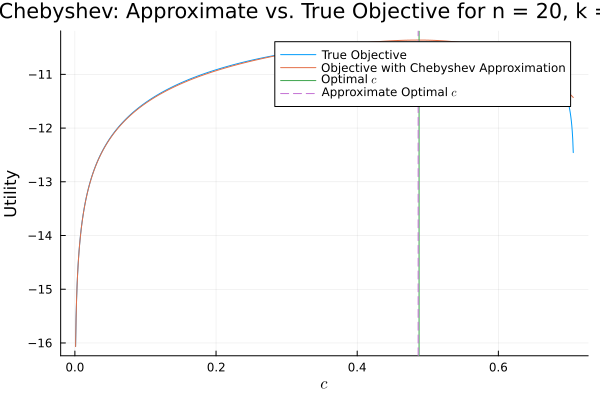

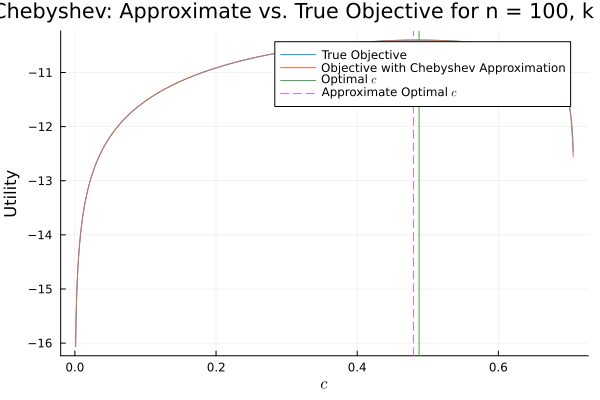

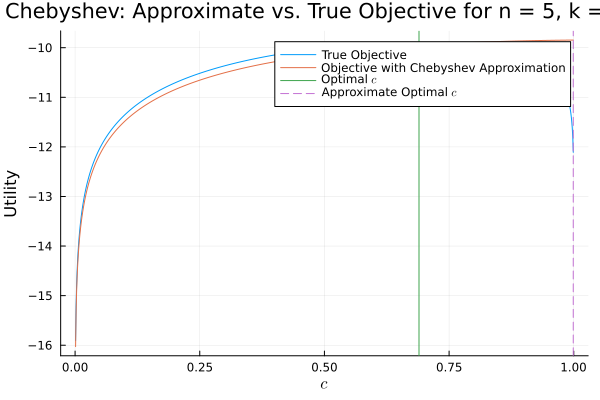

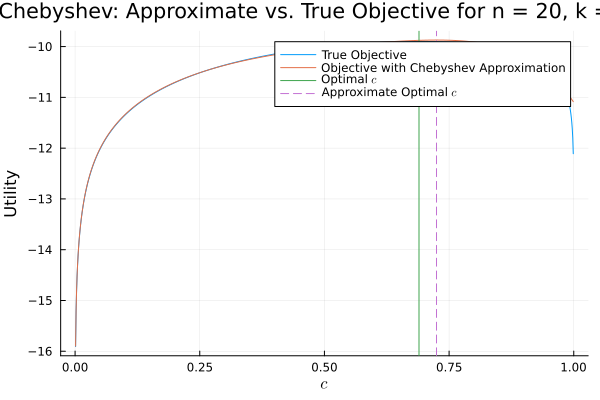

...

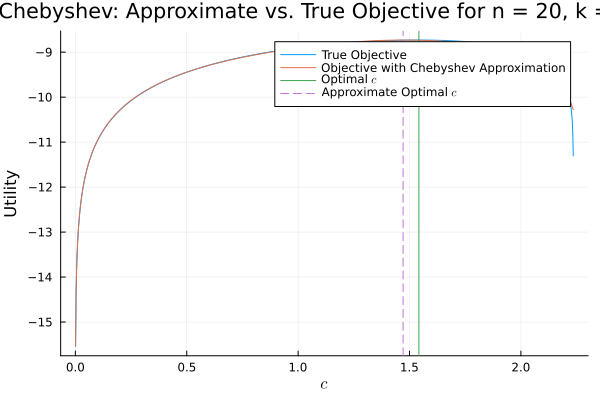

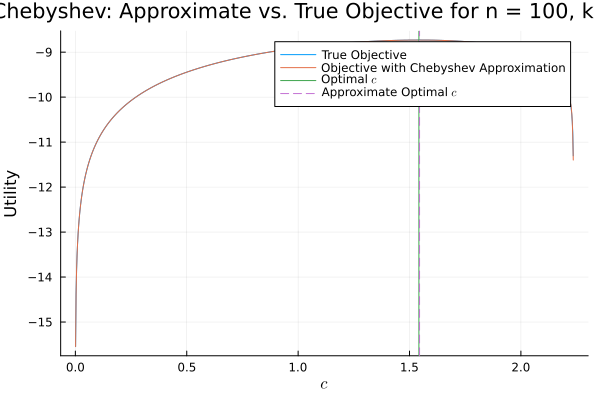

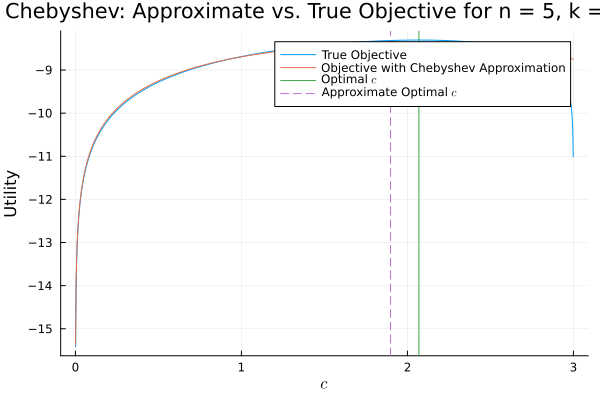

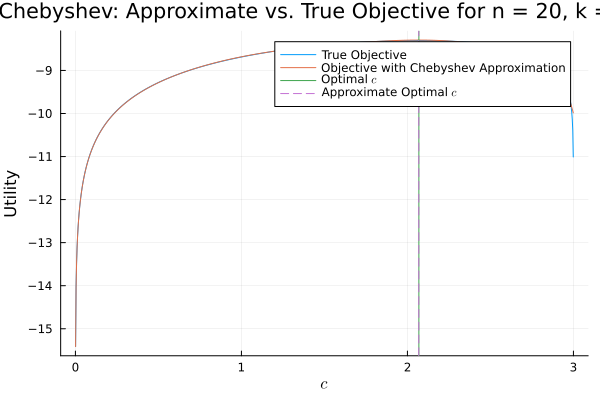

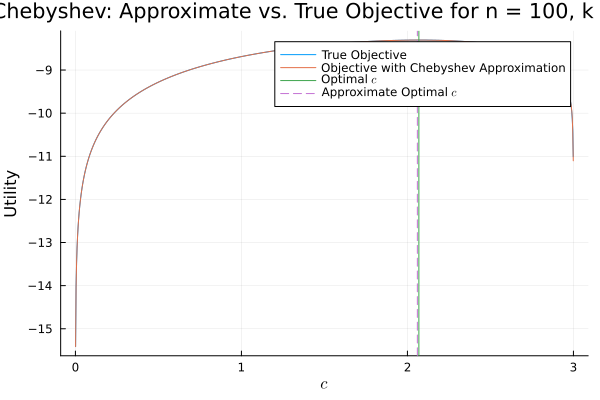

In [101]:
using Plots, Optim, Interpolations

# Define the Chebyshev T function
T(n, z) = cos(n * acos(z))

# Chebyshev interpolation coefficients
function coefficients_cheb(f, a, b, n = 20)
    m = n + 1
    z = [-cos((2k - 1) / (2m) * π) for k = 1:m]
    x = (z .+ 1) .* (b - a) / 2 .+ a
    y = f.(x)

    c = zeros(m)
    for i = 0:n
        num = sum(y[k] * T(i, z[k]) for k in 1:m)
        denom = sum(T(i, z[k])^2 for k in 1:m)
        c[i + 1] = num / denom
    end
    
    return c
end

# Evaluate the Chebyshev polynomial
function eval_chebyshev(c, a, b, x)
    n = length(c) - 1
    z = 2 * (x - a) / (b - a) - 1
    v = zero(promote_type(eltype(c), typeof(x)))

    for (ci, i) in zip(c, 0:n)
        v += ci * T(i, z)
    end
    
    return v
end

# Generate the Chebyshev approximation function
function chebyshev(f, a, b, n = 20)
    c = coefficients_cheb(f, a, b, n)
    return x -> eval_chebyshev(c, a, b, x)
end

# Define parameters
a = -10
b = 0.5
α = 0.5
β = 0.9

# Utility function
v(k) = a + b * log(k)

# Solve for minimum function value and minimum value of k
function solver(α, β, v, k)
    res = optimize(c -> - (log(c) + β * v(k^α - c)), 1e-3, k^α - 1e-3)
    vmax = - Optim.minimum(res)
    cmax = Optim.minimizer(res)  
    return (; v = vmax, c = cmax)
end

function approximated_objective_plot_chebyshev(α, β, v, k; n=20, kwargs...)
    # Define a grid of k values
    k_grid = range(1e-6, stop=10, length=n)

    # Evaluate v at these grid points
    v_values = v.(k_grid)

    # Create the approximation using Chebyshev interpolation
    chebyshev_approx = chebyshev(v, minimum(k_grid), maximum(k_grid), n-1)

    # Define the objective functions
    true_obj(c) = log(c) + β * v(k^α - c)
    approx_obj(c) = log(c) + β * chebyshev_approx(k^α - c)

    # Plot the objective functions
    cg = LinRange(1e-3, k^α - 1e-3, 1000)
    plt = plot(cg, true_obj, label="True Objective", xlabel="\$c\$", ylabel="Utility", 
               title="Chebyshev: Approximate vs. True Objective for n = $n, k = $k", legend=:topright)
    plot!(plt, cg, approx_obj, label="Objective with Chebyshev Approximation")

    # Solve the problem and plot the true and approximate optimal c
    @unpack c = solver(α, β, v, k)
    vline!(plt, [c], label="Optimal \$c\$")

    @unpack c = solver(α, β, chebyshev_approx, k)
    vline!(plt, [c], linestyle=:dash, label="Approximate Optimal \$c\$")

    return plt
end

# Define values to loop over
n_values = [5, 20, 100]
k_values = [0.5, 1, 5, 9]

# Generate and display plots for each combination of k and n values
for k in k_values
    for n in n_values
        plt = approximated_objective_plot_chebyshev(α, β, v, k; n=n)
        display(plt)
    end
end

### Problem 2c

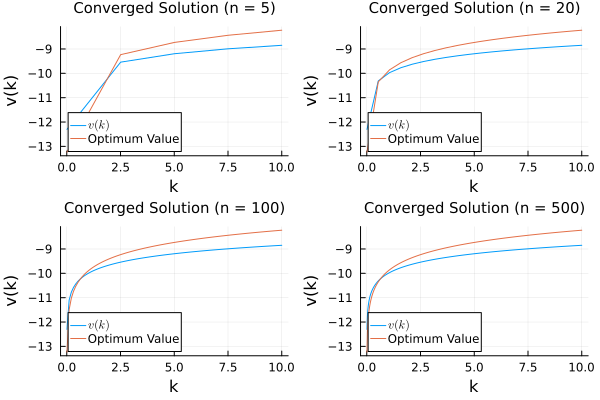

In [96]:
using Plots

kgrids = [LinRange(0.01, 10, 5), LinRange(0.01, 10, 20), LinRange(0.01, 10, 100), LinRange(0.01, 10, 500)]

p = []
for kgrid in kgrids
    title_str = "Converged Solution (n = $(length(kgrid)))"
    p1 = plot(kgrid, v(a, b), label = "\$v(k)\$", title = title_str, titlefontsize = 10)
    plot!(p1, kgrid, k -> solver_v(α, β, v(a, b), k), label = "Optimum Value", xlabel = "k", ylabel = "v(k)", legend = :bottomleft)
    push!(p, p1)
end

plot(p..., layout = (2, 2))

### Problem 2d

In [97]:
using Optim
using Plots

# Define the grid of k values
kgrid = LinRange(0.1, 10, 5)

# Function to calculate v
v(a, b) = k -> a + b * log(k)

# Function to solve for v
function solver_v(α, β, v, k)
    res = optimize(c -> -(log(c) + β * v(k^α - c)), 1e-4, k^α - 1e-4)
    vmax = -Optim.minimum(res)
    return vmax
end

# Function to perform least squares optimization
function least_squares(vi_values)
    @assert length(vi_values) == 5
    kg = LinRange(0.1, 10, 5)
    function sum_squared(p) 
        a, b = p
        v_hat = v(a, b) 
        return sum((v_hat(kg[i]) - vi_values[i])^2 for i in 1:5)
    end
    results = optimize(sum_squared, ones(2), LBFGS())
    return results
end

# Updates values of v
function update_vi_values(a, b)
    vi_values = [solver_v(α, β, v(a, b), k) for k in kgrid]
    return vi_values
end

# Updates values of a and b
function update_ab(a, b)
    vi_values = update_vi_values(a, b)
    results = least_squares(vi_values)
    a_new, b_new = Optim.minimizer(results)
    return a_new, b_new
end

# Initial guess
a_current = -10.0
b_current = 0.5

# Tolerance
tolerance = 1e-8

# Lists to store errors
a_errors = Float64[]
b_errors = Float64[]

# Iterative procedure
while true
    # Update vi values
    vi_values = update_vi_values(a_current, b_current)
    
    # Update a and b
    a_new, b_new = update_ab(a_current, b_current)
    
    # Store errors
    push!(a_errors, abs(a_new - a_current))
    push!(b_errors, abs(b_new - b_current))
    
    # Check for convergence
    if sqrt((a_new - a_current)^2 + (b_new - b_current)^2) < tolerance
        break
    end
    
    # Update for next iteration
    a_current, b_current = a_new, b_new
end

# Output resulting a and b
println("Resulting a: ", a_current)
println("Resulting b: ", b_current)

Resulting a: -12.511614703229775
Resulting b: 0.9090909089928634


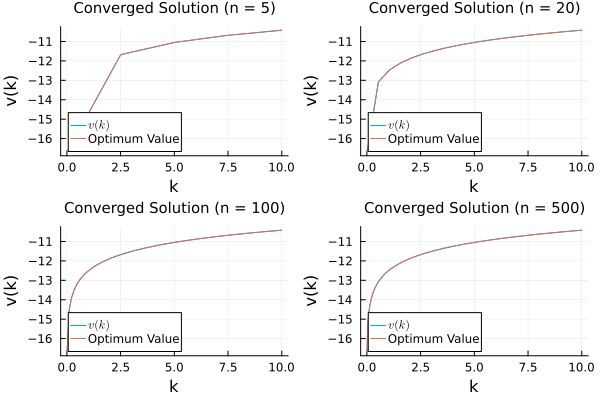

In [98]:
using Plots

kgrids = [LinRange(0.01, 10, 5), LinRange(0.01, 10, 20), LinRange(0.01, 10, 100), LinRange(0.01, 10, 500)]

p = []
for kgrid in kgrids
    title_str = "Converged Solution (n = $(length(kgrid)))"
    p1 = plot(kgrid, v(a_current, b_current), label = "\$v(k)\$", title = title_str, titlefontsize = 10)
    plot!(p1, kgrid, k -> solver_v(α, β, v(a_current, b_current), k), label = "Optimum Value", xlabel = "k", ylabel = "v(k)", legend = :bottomleft)
    push!(p, p1)
end

plot(p..., layout = (2, 2))

We now see that the condition as previously defined does hold for our new values of $a$ and $b$ which we found iteratively. This shows us that value function iteration can be an incredibly useful tool for approximatig the value of functions. We have plotted the error over each iteration which shows that b converges faster than a. 

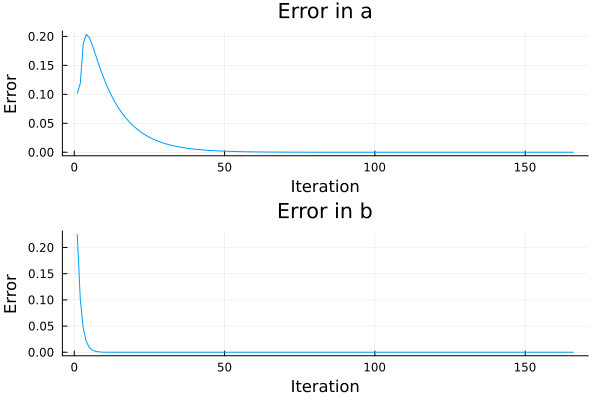

In [99]:
using Plots
# Plot errors
p1 = plot(a_errors, title = "Error in a", xlabel = "Iteration", ylabel = "Error", legend = false)
p2 = plot(b_errors, title = "Error in b", xlabel = "Iteration", ylabel = "Error", legend = false)
plot(p1, p2, layout = (2, 1))